# Charting the Islands: Clustering Hawaii Geographies

In [107]:
# The code was removed by Watson Studio for sharing.

## Downloading the Data

In [3]:
# The code was removed by Watson Studio for sharing.

,GEO.id,GEO.id2,GEO.display-label,HC01_EST_VC01,HC01_MOE_VC01,HC02_EST_VC01,HC02_MOE_VC01,HC03_EST_VC01,HC03_MOE_VC01,HC04_EST_VC01,...,HC04_EST_VC19,HC04_MOE_VC19,HC01_EST_VC20,HC01_MOE_VC20,HC02_EST_VC20,HC02_MOE_VC20,HC03_EST_VC20,HC03_MOE_VC20,HC04_EST_VC20,HC04_MOE_VC20
0,0400000US15,15,Hawaii,455502,2028,317764,2337,236549,2261,137738,...,(X),(X),(X),(X),(X),(X),(X),(X),30.6,(X)
1,0500000US15001,15001,"Hawaii County, Hawaii",67054,945,44937,1136,32268,1127,22117,...,(X),(X),(X),(X),(X),(X),(X),(X),31.9,(X)
2,0500000US15003,15003,"Honolulu County, Hawaii",311451,1436,219859,1659,164797,1597,91592,...,(X),(X),(X),(X),(X),(X),(X),(X),29.9,(X)
3,0500000US15005,15005,"Kalawao County, Hawaii",53,8,15,5,15,5,38,...,(X),(X),(X),(X),(X),(X),(X),(X),28.9,(X)
4,0500000US15007,15007,"Kauai County, Hawaii",22563,460,15723,530,12083,552,6840,...,(X),(X),(X),(X),(X),(X),(X),(X),44.1,(X)


## Data Cleaning

In [4]:
#I just want to see the Median Household Income (MHI) for each county and zipcode. lets also keep number of households as well

##Rename the respective columns I want
#First, mean household income...
df_data_1.rename(columns={"HC01_EST_VC13": "MHI"}, inplace = True)

#Next, households...
df_data_1.rename(columns={"HC01_EST_VC01": "Total Households"}, inplace = True)
df_data_1.rename(columns={"HC02_EST_VC01": "Family Households"}, inplace = True)
df_data_1.rename(columns={"HC04_EST_VC01": "Nonfamily Households"}, inplace = True)
df_data_1.rename(columns={"GEO.id2": "GeoID"}, inplace = True)
df_data_1.rename(columns={"GEO.display-label": "GeoID Label"}, inplace = True)

In [5]:
df_data_1.head()

,GEO.id,GeoID,GeoID Label,Total Households,HC01_MOE_VC01,Family Households,HC02_MOE_VC01,HC03_EST_VC01,HC03_MOE_VC01,Nonfamily Households,...,HC04_EST_VC19,HC04_MOE_VC19,HC01_EST_VC20,HC01_MOE_VC20,HC02_EST_VC20,HC02_MOE_VC20,HC03_EST_VC20,HC03_MOE_VC20,HC04_EST_VC20,HC04_MOE_VC20
0,0400000US15,15,Hawaii,455502,2028,317764,2337,236549,2261,137738,...,(X),(X),(X),(X),(X),(X),(X),(X),30.6,(X)
1,0500000US15001,15001,"Hawaii County, Hawaii",67054,945,44937,1136,32268,1127,22117,...,(X),(X),(X),(X),(X),(X),(X),(X),31.9,(X)
2,0500000US15003,15003,"Honolulu County, Hawaii",311451,1436,219859,1659,164797,1597,91592,...,(X),(X),(X),(X),(X),(X),(X),(X),29.9,(X)
3,0500000US15005,15005,"Kalawao County, Hawaii",53,8,15,5,15,5,38,...,(X),(X),(X),(X),(X),(X),(X),(X),28.9,(X)
4,0500000US15007,15007,"Kauai County, Hawaii",22563,460,15723,530,12083,552,6840,...,(X),(X),(X),(X),(X),(X),(X),(X),44.1,(X)


In [6]:
#Check that the rename worked...

for col in df_data_1.columns:
    print(col)

GEO.id
GeoID
GeoID Label
Total Households
HC01_MOE_VC01
Family Households
HC02_MOE_VC01
HC03_EST_VC01
HC03_MOE_VC01
Nonfamily Households
HC04_MOE_VC01
HC01_EST_VC02
HC01_MOE_VC02
HC02_EST_VC02
HC02_MOE_VC02
HC03_EST_VC02
HC03_MOE_VC02
HC04_EST_VC02
HC04_MOE_VC02
HC01_EST_VC03
HC01_MOE_VC03
HC02_EST_VC03
HC02_MOE_VC03
HC03_EST_VC03
HC03_MOE_VC03
HC04_EST_VC03
HC04_MOE_VC03
HC01_EST_VC04
HC01_MOE_VC04
HC02_EST_VC04
HC02_MOE_VC04
HC03_EST_VC04
HC03_MOE_VC04
HC04_EST_VC04
HC04_MOE_VC04
HC01_EST_VC05
HC01_MOE_VC05
HC02_EST_VC05
HC02_MOE_VC05
HC03_EST_VC05
HC03_MOE_VC05
HC04_EST_VC05
HC04_MOE_VC05
HC01_EST_VC06
HC01_MOE_VC06
HC02_EST_VC06
HC02_MOE_VC06
HC03_EST_VC06
HC03_MOE_VC06
HC04_EST_VC06
HC04_MOE_VC06
HC01_EST_VC07
HC01_MOE_VC07
HC02_EST_VC07
HC02_MOE_VC07
HC03_EST_VC07
HC03_MOE_VC07
HC04_EST_VC07
HC04_MOE_VC07
HC01_EST_VC08
HC01_MOE_VC08
HC02_EST_VC08
HC02_MOE_VC08
HC03_EST_VC08
HC03_MOE_VC08
HC04_EST_VC08
HC04_MOE_VC08
HC01_EST_VC09
HC01_MOE_VC09
HC02_EST_VC09
HC02_MOE_VC09
HC03_EST_

In [7]:
#simplifying our dataframe

df_simple = df_data_1[['GeoID', 'GeoID Label', 'MHI', 'Total Households','Family Households','Nonfamily Households']]

In [8]:
df_simple.head(7)

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households
0,15,Hawaii,74923,455502,317764,137738
1,15001,"Hawaii County, Hawaii",56395,67054,44937,22117
2,15003,"Honolulu County, Hawaii",80078,311451,219859,91592
3,15005,"Kalawao County, Hawaii",61750,53,15,38
4,15007,"Kauai County, Hawaii",72330,22563,15723,6840
5,15009,"Maui County, Hawaii",72762,54381,37230,17151
6,96701,ZCTA5 96701,91646,13080,9329,3751


In [9]:
df_simple.dtypes
#so it looks like we need to change MHI into a numeric

GeoID                    int64
GeoID Label             object
MHI                     object
Total Households         int64
Family Households        int64
Nonfamily Households     int64
dtype: object

In [10]:
#What does our null data look like?
df_simple[df_simple['MHI'] == '-']

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households
43,96751,ZCTA5 96751,-,27,0,27
50,96759,ZCTA5 96759,-,75,75,0
64,96774,ZCTA5 96774,-,66,66,0
94,96850,ZCTA5 96850,-,0,0,0
95,96853,ZCTA5 96853,-,0,0,0
96,96857,ZCTA5 96857,-,0,0,0
97,96859,ZCTA5 96859,-,0,0,0
98,96860,ZCTA5 96860,-,0,0,0
99,96863,ZCTA5 96863,-,0,0,0


In [11]:
#I don't want to replace these empty MHI stats with 0, because that would radically skew the data
#considering how small they are, and considering the Census bureau deems them too small to get accurate data, I'm willing to drop them

import numpy as np

df_simple.replace("-", np.nan, inplace = True)
df_simple = df_simple.dropna()

#changing type of the MHI column to int
df_simple['MHI'] = df_simple['MHI'].astype(np.int64)

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


In [12]:
#checking that our MHI variable is integer now
df_simple.dtypes

GeoID                    int64
GeoID Label             object
MHI                      int64
Total Households         int64
Family Households        int64
Nonfamily Households     int64
dtype: object

In [13]:
#creating a % of State MHI column
df_simple['% of State MHI'] = np.round_(np.divide(df_simple['MHI'], df_simple.loc[df_simple['GeoID'] == 15, 'MHI']), decimals = 2)

In [14]:
#checking how our cleaned, simplified base dataframe looks like
df_simple

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI
0,15,Hawaii,74923,455502,317764,137738,1.00
1,15001,"Hawaii County, Hawaii",56395,67054,44937,22117,0.75
2,15003,"Honolulu County, Hawaii",80078,311451,219859,91592,1.07
3,15005,"Kalawao County, Hawaii",61750,53,15,38,0.82
4,15007,"Kauai County, Hawaii",72330,22563,15723,6840,0.97
5,15009,"Maui County, Hawaii",72762,54381,37230,17151,0.97
6,96701,ZCTA5 96701,91646,13080,9329,3751,1.22
7,96703,ZCTA5 96703,62500,594,404,190,0.83
8,96704,ZCTA5 96704,51483,2578,1854,724,0.69
9,96705,ZCTA5 96705,75938,761,595,166,1.01


## Separating the Tables

### State Dataframe

In [15]:
#this is basically just a single row

df_state = df_simple[df_simple['GeoID'] == 15]
df_state

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI
0,15,Hawaii,74923,455502,317764,137738,1.0


### County Dataframe

In [16]:
#county df

df_county = df_simple[df_simple['GeoID Label'].str.contains("County")]

#Cleaning the GeoID Label to be just the name of the county

new = df_county['GeoID Label'].str.split(" ", n = 1, expand = True)
df_county['County'] = new[0]
df_county.drop(columns = ['GeoID Label'], inplace = True)

#now to rearrange columns,
df_county = df_county[['GeoID', 'County', 'MHI', 'Total Households', 'Family Households', 'Nonfamily Households', '% of State MHI']]

df_county

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


,GeoID,County,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI
1,15001,Hawaii,56395,67054,44937,22117,0.75
2,15003,Honolulu,80078,311451,219859,91592,1.07
3,15005,Kalawao,61750,53,15,38,0.82
4,15007,Kauai,72330,22563,15723,6840,0.97
5,15009,Maui,72762,54381,37230,17151,0.97


### Zip Code Dataframe

In [17]:
#zip code df
#This is going to be the complex one because it is our lowest level of nested data and the one we will do most of our analyses

df_zip = df_simple[df_simple['GeoID Label'].str.contains("ZCTA5")]
df_zip

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI
6,96701,ZCTA5 96701,91646,13080,9329,3751,1.22
7,96703,ZCTA5 96703,62500,594,404,190,0.83
8,96704,ZCTA5 96704,51483,2578,1854,724,0.69
9,96705,ZCTA5 96705,75938,761,595,166,1.01
10,96706,ZCTA5 96706,98248,18988,15708,3280,1.31
11,96707,ZCTA5 96707,99946,12889,10363,2526,1.33
12,96708,ZCTA5 96708,81919,3504,2250,1254,1.09
13,96710,ZCTA5 96710,44167,134,67,67,0.59
14,96712,ZCTA5 96712,79459,2621,1705,916,1.06
15,96713,ZCTA5 96713,53500,424,235,189,0.71


In [18]:
##Adding in a df that has county labels for the zip codes

body = client_1ac46fe64048461aa02020f0a715fcf7.get_object(Bucket='hawaiimhi-donotdelete-pr-igsbuppvuweugf',Key='County Zipcodes.xlsx')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_0 = pd.read_excel(body)
df_data_0.head()

,Zip Code,City,County
0,96701,Aiea,Honolulu County
1,96703,Anahola,Kauai County
2,96704,Captain Cook,Hawaii County
3,96705,Eleele,Kauai County
4,96706,Ewa Beach,Honolulu County


In [19]:
df_zip.head()

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI
6,96701,ZCTA5 96701,91646,13080,9329,3751,1.22
7,96703,ZCTA5 96703,62500,594,404,190,0.83
8,96704,ZCTA5 96704,51483,2578,1854,724,0.69
9,96705,ZCTA5 96705,75938,761,595,166,1.01
10,96706,ZCTA5 96706,98248,18988,15708,3280,1.31


In [20]:
#Joining the county/zip code to df into the main zip code df

df_zip = df_zip.set_index('GeoID').join(df_data_0.set_index('Zip Code'))
df_zip.reset_index(drop = False, inplace = True)
df_zip

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County
0,96701,ZCTA5 96701,91646,13080,9329,3751,1.22,Aiea,Honolulu County
1,96703,ZCTA5 96703,62500,594,404,190,0.83,Anahola,Kauai County
2,96704,ZCTA5 96704,51483,2578,1854,724,0.69,Captain Cook,Hawaii County
3,96705,ZCTA5 96705,75938,761,595,166,1.01,Eleele,Kauai County
4,96706,ZCTA5 96706,98248,18988,15708,3280,1.31,Ewa Beach,Honolulu County
5,96707,ZCTA5 96707,99946,12889,10363,2526,1.33,Kapolei,Honolulu County
6,96708,ZCTA5 96708,81919,3504,2250,1254,1.09,Haiku,Maui County
7,96710,ZCTA5 96710,44167,134,67,67,0.59,Hakalau,Hawaii County
8,96712,ZCTA5 96712,79459,2621,1705,916,1.06,Haleiwa,Honolulu County
9,96713,ZCTA5 96713,53500,424,235,189,0.71,Hana,Maui County


In [21]:
df_zip.groupby('GeoID').count() #checking for abnormal counts (like duplicates)

,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County
GeoID,,,,,,,,
96701,1,1,1,1,1,1,1,1
96703,1,1,1,1,1,1,1,1
96704,1,1,1,1,1,1,1,1
96705,1,1,1,1,1,1,1,1
96706,1,1,1,1,1,1,1,1
96707,1,1,1,1,1,1,1,1
96708,1,1,1,1,1,1,1,1
96710,1,1,1,1,1,1,1,1
96712,1,1,1,1,1,1,1,1


In [22]:
#check that our number of rows in each df is the same as when we started. We don't want duplicates.

df_zip.shape[0] + df_county.shape[0] + df_state.shape [0] == df_simple.shape[0]

True

In [23]:
#adding lat and lon data to zip codes. This is data from the Hawaii State GIS project
body = client_1ac46fe64048461aa02020f0a715fcf7.get_object(Bucket='hawaiimhi-donotdelete-pr-igsbuppvuweugf',Key='2015_Census_Zip_Code_Tabulation_Areas_ZCTA.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_2 = pd.read_csv(body)
df_data_2.head()

,objectid,zcta5ce10,geoid10,classfp10,mtfcc10,funcstat10,aland10,awater10,intptlat10,intptlon10,...,modifiedby,agency,deliverydate,sourceid,severity,publishdate,comments,pop15,st_areashape,st_lengthshape
0,1,96701,96701,B5,G6350,S,48965615,2013466,21.406053,-157.884952,...,NaN,,2016-09-13T00:00:00.000Z,NaN,NaN,1899-12-30T00:00:00.000Z,NaN,39270,5.095442e+07,0
1,2,96703,96703,B5,G6350,S,48479203,4319417,22.145578,-159.385681,...,NaN,,2016-09-13T00:00:00.000Z,NaN,NaN,1899-12-30T00:00:00.000Z,NaN,2162,5.276006e+07,0
2,3,96704,96704,B5,G6350,S,738013505,57244562,19.337269,-155.837622,...,NaN,,2016-09-13T00:00:00.000Z,NaN,NaN,1899-12-30T00:00:00.000Z,NaN,7873,7.968249e+08,0
3,4,96705,96705,B5,G6350,S,7534482,1270446,21.899532,-159.568545,...,NaN,,2016-09-13T00:00:00.000Z,NaN,NaN,1899-12-30T00:00:00.000Z,NaN,2512,8.798814e+06,0
4,5,96706,96706,B5,G6350,S,44291604,4791628,21.344763,-158.022279,...,NaN,,2016-09-13T00:00:00.000Z,NaN,NaN,1899-12-30T00:00:00.000Z,NaN,67146,4.905633e+07,0


In [24]:
df_data_2.dtypes #intpltlat10 and intpltlon10 are the latitude and longitude variables we want

objectid            int64
zcta5ce10           int64
geoid10             int64
classfp10          object
mtfcc10            object
funcstat10         object
aland10             int64
awater10            int64
intptlat10        float64
intptlon10        float64
featureuid         object
createdate        float64
createdby          object
modifieddate      float64
modifiedby        float64
agency             object
deliverydate       object
sourceid          float64
severity          float64
publishdate        object
comments          float64
pop15               int64
st_areashape      float64
st_lengthshape      int64
dtype: object

In [25]:
df_data_2 = df_data_2[['geoid10', 'intptlat10', 'intptlon10']] #just taking the columns of data we care about

In [26]:
df_zip = df_zip.set_index('GeoID').join(df_data_2.set_index('geoid10'))
df_zip.reset_index(drop = False, inplace = True)
df_zip.head()

,GeoID,GeoID Label,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County,intptlat10,intptlon10
0,96701,ZCTA5 96701,91646,13080,9329,3751,1.22,Aiea,Honolulu County,21.406053,-157.884952
1,96703,ZCTA5 96703,62500,594,404,190,0.83,Anahola,Kauai County,22.145578,-159.385681
2,96704,ZCTA5 96704,51483,2578,1854,724,0.69,Captain Cook,Hawaii County,19.337269,-155.837622
3,96705,ZCTA5 96705,75938,761,595,166,1.01,Eleele,Kauai County,21.899532,-159.568545
4,96706,ZCTA5 96706,98248,18988,15708,3280,1.31,Ewa Beach,Honolulu County,21.344763,-158.022279


In [27]:
#some minor cleaning--

#renaming that new first column and changing zipcode to string (this is for the visualizations later on)
df_zip['Zip Code'] = df_zip['GeoID'].astype(str)

#renaming the lat and longitude
df_zip.rename(columns={"intptlat10": 'Latitude', "intptlon10": 'Longitude'}, inplace = True)

#getting rid of the GeoID columns
df_zip.drop(['GeoID Label'], axis = 1, inplace = True) 
df_zip.drop(['GeoID'], axis = 1, inplace = True)

In [28]:
df_zip.head()

,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County,Latitude,Longitude,Zip Code
0,91646,13080,9329,3751,1.22,Aiea,Honolulu County,21.406053,-157.884952,96701
1,62500,594,404,190,0.83,Anahola,Kauai County,22.145578,-159.385681,96703
2,51483,2578,1854,724,0.69,Captain Cook,Hawaii County,19.337269,-155.837622,96704
3,75938,761,595,166,1.01,Eleele,Kauai County,21.899532,-159.568545,96705
4,98248,18988,15708,3280,1.31,Ewa Beach,Honolulu County,21.344763,-158.022279,96706


So we have three dataframes:
for the **state (df_state)**, for the **counties(df_county)**, for the **zip codes (df_zip)**

We need to normalize our features in the data if we want to do analyses on them
>the features we want: **family households, nonfamily households, MHI, venues**



### Joining in Foursquare Venue Data
> We'll be focusing on the zip codes for more localized data. Getting venues within counties is a bit too broad range, especially considering these counties cross literal islands. First, we need the latitude and longitudes from an API call

In [29]:
# The code was removed by Watson Studio for sharing.

In [30]:
#creating a function to get venues

def getNearbyVenues(names, latitudes, longitudes, radius=2500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Zip Code', 
                  'Zip Code Latitude', 
                  'Zip Code Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [31]:
zip_venues = getNearbyVenues(names = df_zip['Zip Code'], 
                             latitudes = df_zip['Latitude'], 
                             longitudes = df_zip['Longitude']
                            )

96701
96703
96704
96705
96706
96707
96708
96710
96712
96713
96714
96716
96717
96719
96720
96722
96725
96726
96727
96728
96729
96730
96731
96732
96734
96737
96738
96740
96741
96742
96743
96744
96746
96747
96748
96749
96750
96752
96753
96754
96755
96756
96757
96760
96761
96762
96763
96764
96765
96766
96768
96769
96770
96771
96772
96773
96776
96777
96778
96779
96780
96781
96782
96783
96785
96786
96789
96790
96791
96792
96793
96795
96796
96797
96813
96814
96815
96816
96817
96818
96819
96821
96822
96825
96826


In [32]:
print(zip_venues.shape)
zip_venues.head()

(1565, 7)


,Zip Code,Zip Code Latitude,Zip Code Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,96701,21.406053,-157.884952,Aiea Loop Trail,21.398277,-157.900615,Trail
1,96701,21.406053,-157.884952,Keaiwa Heiau State Park,21.396906,-157.904487,Trail
2,96701,21.406053,-157.884952,Moanalua Golf Club Course,21.405262,-157.868761,Golf Course
3,96701,21.406053,-157.884952,Epowersports,21.392480,-157.876898,Hobby Shop
4,96701,21.406053,-157.884952,A Reef Encounter,21.399556,-157.907224,Fish Market


In [33]:
#just to see how many venues are in each zip code
zip_venues.groupby('Zip Code').count()

,Zip Code Latitude,Zip Code Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Zip Code,,,,,,
96701,5,5,5,5,5,5
96705,30,30,30,30,30,30
96706,44,44,44,44,44,44
96707,13,13,13,13,13,13
96712,5,5,5,5,5,5
96719,14,14,14,14,14,14
96722,7,7,7,7,7,7
96725,2,2,2,2,2,2
96728,10,10,10,10,10,10


In [40]:
zip_venues.groupby('Zip Code').count().describe() #to see our spread of venue data

,Zip Code Latitude,Zip Code Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
count,58.000000,58.000000,58.000000,58.000000,58.000000,58.000000
mean,26.982759,26.982759,26.982759,26.982759,26.982759,26.982759
std,34.258302,34.258302,34.258302,34.258302,34.258302,34.258302
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,3.250000,3.250000,3.250000,3.250000,3.250000,3.250000
50%,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000
75%,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000
max,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000


In [89]:
#Dummy code the venues for each of the zip codes

zip_onehot = pd.get_dummies(zip_venues[['Venue Category']], prefix = "", prefix_sep = "")

#add zip codes in
zip_onehot['Zip Code'] = df_zip['Zip Code']

#moving zip codes to the front
fixed_columns = [zip_onehot.columns[-1]] + list(zip_onehot.columns[:-1])
zip_onehot = zip_onehot[fixed_columns]

zip_onehot.head()

,Zip Code,ATM,Airport,Airport Terminal,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,...,Video Store,Vietnamese Restaurant,Warehouse Store,Waterfall,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo
0,96701,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,96703,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,96704,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,96705,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,96706,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [90]:
#to see the whole spread, just to see if we have any duplicate zip codes turning up somewhere.

pd.set_option('display.max_rows', None)
zip_onehot.groupby('Zip Code').count()
#looks like we're in the clear

,ATM,Airport,Airport Terminal,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,...,Video Store,Vietnamese Restaurant,Warehouse Store,Waterfall,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo
Zip Code,,,,,,,,,,,,,,,,,,,,,
96701,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96703,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96704,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96705,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96706,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96707,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96708,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96710,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
96712,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


Now that we collected and dummycoded our venues, now we need to gather the rest of our features

In [91]:
#We need our features for analyses--the stuff we're going to be grouping on

Features = ['MHI', 'Family Households', 'Nonfamily Households', 'Zip Code']
X = df_zip[Features].set_index('Zip Code').join(zip_onehot.set_index('Zip Code'))
X

,MHI,Family Households,Nonfamily Households,ATM,Airport,Airport Terminal,American Restaurant,Antique Shop,Art Gallery,Art Museum,...,Video Store,Vietnamese Restaurant,Warehouse Store,Waterfall,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo
Zip Code,,,,,,,,,,,,,,,,,,,,,
96701,91646,9329,3751,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96703,62500,404,190,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96704,51483,1854,724,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96705,75938,595,166,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96706,98248,15708,3280,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96707,99946,10363,2526,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96708,81919,2250,1254,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96710,44167,67,67,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
96712,79459,1705,916,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [92]:
#AND we need those features normalized so they can be appropriately compared with each other
X = np.nan_to_num(X)
X = preprocessing.StandardScaler().fit(X).transform(X)

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [93]:
X

array([[ 1.26390365,  1.2628089 ,  1.03885273, ...,  0.        ,
         0.        ,  0.        ],
       [-0.21523346, -0.75257876, -0.6967256 , ...,  0.        ,
         0.        ,  0.        ],
       [-0.77433775, -0.42514883, -0.43646195, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [ 0.12595362,  1.3777481 ,  3.42167847, ...,  0.        ,
         0.        ,  0.        ],
       [ 2.33303772,  1.01780099,  0.29510307, ...,  0.        ,
         0.        ,  0.        ],
       [-0.95485277,  0.6745641 ,  3.10926462, ...,  0.        ,
         0.        ,  0.        ]])

So now we have a standardized df with our features of interest

# Clustering Analyses
> I'm interested in trying two kinds of clustering: K-Nearest Neighbor (KNN) and DBSCAN
\
\
KNN- This is a classic technique, so its a good baseline starting point for clustering. Also, considering the wide berth of points we're looking at here, we could have not only a lot of potential "clusters" themselves (maybe 2? 7? 12?), but also a lot of stuff within each cluster too. In other words, KNN offers an unsupervised, classic way to cluster this amount of data we have.
\
\
DBSCAN- This is the analyses I'm more interested in and I'll tell you why. DBSCAN is a density-based analyses--i.e. it looks very precisely at how 'close' things are to each other and only puts the stuff together that really fits. Consequently, it handles outliers really well and, considering our data, I think that will be pretty important. 

First, lets try our classic KNN.
### KNN

In [94]:
from sklearn.cluster import KMeans

#running the analyses
kmeans = KMeans(n_clusters = 2, random_state = 0).fit(X)

In [95]:
#lets look at the actual labels
kmeans.labels_

array([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
      dtype=int32)

In [96]:
#Lets see the spread
unique, counts = np.unique(kmeans.labels_, return_counts = True)
dict(zip(unique, counts))

{0: 56, 1: 29}

Admittedly, not super helpful. With 2 clusters, we can tell that there are 56 zip codes in one cluster, and 29 in another. Lets iterate through to see what categories look promising

In [97]:
for clusters in range (1, 20):
    kmeans = KMeans(n_clusters = clusters, random_state = 0).fit(X)
    unique, counts = np.unique(kmeans.labels_, return_counts = True)
    print(dict(zip(unique, counts)))

{0: 85}
{0: 56, 1: 29}
{0: 57, 1: 1, 2: 27}
{0: 1, 1: 28, 2: 55, 3: 1}
{0: 2, 1: 28, 2: 3, 3: 2, 4: 50}
{0: 1, 1: 60, 2: 1, 3: 20, 4: 2, 5: 1}
{0: 1, 1: 2, 2: 56, 3: 19, 4: 2, 5: 2, 6: 3}
{0: 1, 1: 50, 2: 3, 3: 22, 4: 2, 5: 2, 6: 3, 7: 2}
{0: 2, 1: 3, 2: 2, 3: 20, 4: 49, 5: 2, 6: 2, 7: 2, 8: 3}
{0: 2, 1: 52, 2: 2, 3: 18, 4: 2, 5: 2, 6: 1, 7: 2, 8: 2, 9: 2}
{0: 1, 1: 3, 2: 3, 3: 3, 4: 1, 5: 15, 6: 19, 7: 4, 8: 31, 9: 2, 10: 3}
{0: 3, 1: 4, 2: 1, 3: 42, 4: 2, 5: 2, 6: 18, 7: 2, 8: 3, 9: 2, 10: 3, 11: 3}
{0: 2, 1: 2, 2: 35, 3: 3, 4: 11, 5: 3, 6: 1, 7: 2, 8: 17, 9: 2, 10: 3, 11: 2, 12: 2}
{0: 1, 1: 3, 2: 3, 3: 3, 4: 1, 5: 13, 6: 18, 7: 4, 8: 29, 9: 2, 10: 3, 11: 2, 12: 2, 13: 1}
{0: 1, 1: 3, 2: 3, 3: 3, 4: 1, 5: 13, 6: 16, 7: 4, 8: 29, 9: 2, 10: 3, 11: 2, 12: 2, 13: 1, 14: 2}
{0: 2, 1: 39, 2: 2, 3: 2, 4: 2, 5: 4, 6: 3, 7: 14, 8: 3, 9: 2, 10: 3, 11: 2, 12: 3, 13: 2, 14: 1, 15: 1}
{0: 1, 1: 3, 2: 3, 3: 3, 4: 1, 5: 11, 6: 14, 7: 4, 8: 29, 9: 2, 10: 3, 11: 2, 12: 2, 13: 1, 14: 2, 15: 2, 16: 2}

We don't want too many groups, then whats the point of grouping them? (imagine if, having 100 zip codes, we insisted on 100 clusters, which would be one cluster per zip code...which is rather pointless). So we want the least amount of groups possible. But also having only two, like that first test, is rather small.

To my eye, it looks like **11 clusters** seems like a good one to look at more. Why? Well, its the smallest number of groups that has **no clusters with more than a half of the entire sample**

I will totally admit, this decisionmaking is a bit arbitray. Heck, we're not 'predicting' anything, so I can't really run analyses to tell you that one group is more or less "accurate" than another. We're just looking at how to group them. But, for getting relatively parsimonious descriptive picture, I think this is decent.

In [98]:
kclusters = 11
kmeans = KMeans(n_clusters = kclusters, random_state = 0).fit(X)

In [99]:
#Putting our KNN Labels to our zip codes

df_zip.insert(0, 'KNN Cluster', kmeans.labels_)
df_zip

,KNN Cluster,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County,Latitude,Longitude,Zip Code
0,1,91646,13080,9329,3751,1.22,Aiea,Honolulu County,21.406053,-157.884952,96701
1,1,62500,594,404,190,0.83,Anahola,Kauai County,22.145578,-159.385681,96703
2,7,51483,2578,1854,724,0.69,Captain Cook,Hawaii County,19.337269,-155.837622,96704
3,8,75938,761,595,166,1.01,Eleele,Kauai County,21.899532,-159.568545,96705
4,6,98248,18988,15708,3280,1.31,Ewa Beach,Honolulu County,21.344763,-158.022279,96706
5,6,99946,12889,10363,2526,1.33,Kapolei,Honolulu County,21.363106,-158.082206,96707
6,9,81919,3504,2250,1254,1.09,Haiku,Maui County,20.852389,-156.223562,96708
7,10,44167,134,67,67,0.59,Hakalau,Hawaii County,19.842479,-155.247512,96710
8,6,79459,2621,1705,916,1.06,Haleiwa,Honolulu County,21.621367,-158.048011,96712
9,8,53500,424,235,189,0.71,Hana,Maui County,20.738821,-156.045046,96713


### DBSCAN (Density Based Clustering)

In [100]:
#we need to find the optimal epsilon value. 
#I.e. we need to know how close we should expect values to be near each other for us to call them a "cluster"

from sklearn.neighbors import NearestNeighbors

neigh = NearestNeighbors(n_neighbors = 2)

nbrs = neigh.fit(X)

distances, indices = nbrs.kneighbors(X)

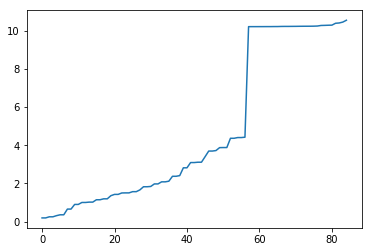

In [101]:
distances = np.sort(distances, axis = 0)

distances = distances[:, 1]

plt.plot(distances) #our optimal value of epsilon is the point of maximum curvature

In [ ]:
from sklearn.cluster import DBSCAN
import sklearn.utils

sklearn.utils.check_random_state(1000)

#Compute DBSCAN
db = DBSCAN(eps = 6, min_samples = 2).fit(X)
core_samples_mask = np.zeros_like(db.labels_, dtype = bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

realClusterNum=len(set(labels)) - (1 if -1 in labels else 0)
clusterNum = len(set(labels))

In [108]:
labels #anything with a -1, DBSCAN is saying is far out. An "outlier"

array([ 0,  0,  1, -1, -1, -1,  2,  3,  4,  5,  6, -1, -1,  7,  8,  5, -1,
        2,  9,  3, -1, -1, -1, -1, 10, 11, -1, -1, 12, -1, -1,  3, 13, -1,
        4, -1,  6, -1, 14, 15, 15,  6, -1,  1, -1,  6, -1,  1, -1, 16, 17,
       10, -1, -1,  8, 12, 18, -1, -1, 16,  9, 19, 20, 12, 21,  4,  1, 18,
       14, -1, 18,  0, -1, 19,  4, 20, -1, 12,  7, 13, 11, 17, 10,  6, 21])

In [109]:
#Adding our DBSCAN cluster labels into our zip codes df

df_zip.insert(0, 'DBSCAN Cluster', db.labels_)
df_zip

,DBSCAN Cluster,KNN Cluster,MHI,Total Households,Family Households,Nonfamily Households,% of State MHI,City,County,Latitude,Longitude,Zip Code
0,0,1,91646,13080,9329,3751,1.22,Aiea,Honolulu County,21.406053,-157.884952,96701
1,0,1,62500,594,404,190,0.83,Anahola,Kauai County,22.145578,-159.385681,96703
2,1,7,51483,2578,1854,724,0.69,Captain Cook,Hawaii County,19.337269,-155.837622,96704
3,-1,8,75938,761,595,166,1.01,Eleele,Kauai County,21.899532,-159.568545,96705
4,-1,6,98248,18988,15708,3280,1.31,Ewa Beach,Honolulu County,21.344763,-158.022279,96706
5,-1,6,99946,12889,10363,2526,1.33,Kapolei,Honolulu County,21.363106,-158.082206,96707
6,2,9,81919,3504,2250,1254,1.09,Haiku,Maui County,20.852389,-156.223562,96708
7,3,10,44167,134,67,67,0.59,Hakalau,Hawaii County,19.842479,-155.247512,96710
8,4,6,79459,2621,1705,916,1.06,Haleiwa,Honolulu County,21.621367,-158.048011,96712
9,5,8,53500,424,235,189,0.71,Hana,Maui County,20.738821,-156.045046,96713


### Comparing the Clusters
> Now that we have our clusters, lets do a quick correlation to see how related they are

In [110]:
import scipy.stats

scipy.stats.pearsonr(df_zip['DBSCAN Cluster'], df_zip['KNN Cluster'])

(-0.24010499554053086, 0.026872239294808743)

Our pearson-r correlation coefficient is -.24 and our p value is < 0.05, which is a significant relationship

# Visualizing the Data

## Maps

*First off, lets see these data on a map*

In [111]:
!pip install folium
import folium

     |████████████████████████████████| 92kB 9.1MB/s eta 0:00:011


First, making a general map of Hawaii

In [112]:
latitude = 19.8968
longitude = -155.5828

Hawaii_map = folium.Map(location=[latitude, longitude], zoom_start = 7)
Hawaii_map

In [113]:
#download the geojson file from Hawaii State's GIS Project site
!wget --quiet https://opendata.arcgis.com/datasets/cef8796083d34934bbea610a3d06c7c3_5.geojson

In [114]:
county_geo = r'cef8796083d34934bbea610a3d06c7c3_5.geojson'

In [115]:
df_county.dtypes#checking the types of data here to make sure we can tie them together properly

GeoID                     int64
County                   object
MHI                       int64
Total Households          int64
Family Households         int64
Nonfamily Households      int64
% of State MHI          float64
dtype: object

In [116]:
df_zip.dtypes

DBSCAN Cluster            int64
KNN Cluster               int32
MHI                       int64
Total Households          int64
Family Households         int64
Nonfamily Households      int64
% of State MHI          float64
City                     object
County                   object
Latitude                float64
Longitude               float64
Zip Code                 object
dtype: object

**County Map**

In [117]:
#County Map
latitude = 19.8968
longitude = -155.5828

HIcounty_map = folium.Map(location=[latitude, longitude], zoom_start = 7)
HIcounty_map

choropleth = folium.Choropleth(
    geo_data = county_geo,
    data = df_county,
    columns = ['County', 'MHI'],
    key_on = 'feature.properties.name',
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity= 0.2,
    legend_name = "MHI"
).add_to(HIcounty_map)

In [118]:
HIcounty_map

Now, to the **Zip Code Map**

In [119]:
#download the geojson file
!wget --quiet https://opendata.arcgis.com/datasets/ca2129be6a754ca3a255d438e82c6ae2_8.geojson

In [120]:
zip_geo = r'ca2129be6a754ca3a255d438e82c6ae2_8.geojson'

In [121]:
#for future reference if you want to look at the contents of a json file to see which properties to bind to
#import json
#with open(zip_geo) as f:
    #data = json.load(f)

#data

In [122]:
#Zip Code Map
latitude = 19.8968
longitude = -155.5828

HIzip_map = folium.Map(location=[latitude, longitude], zoom_start = 7)
HIzip_map

#plotting the boundaries
folium.Choropleth(
    geo_data = zip_geo,
    data = df_zip,
    columns = ['Zip Code', 'MHI'],
    key_on = 'feature.properties.zcta5ce10',
    fill_color = 'YlOrRd',
    fill_opacity = 0.6,
    line_opacity= .4,
    legend_name = "MHI",
).add_to(HIzip_map)

In [123]:
#Adding descriptive markers

for lat, lng, code, MHI, percent, county in zip(df_zip['Latitude'], df_zip['Longitude'], 
                                                df_zip['Zip Code'], df_zip['MHI'], df_zip['% of State MHI'], df_zip['County']):
    label = '{},\n Zip Code: {},\n MHI: ${},\n % of State MHI: {}'.format(county, code, MHI, percent)
    label = folium.Tooltip(label)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        tooltip=label,
        color='blue',
        weight = 1,
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.5,
        parse_html=False).add_to(HIzip_map)

#### Alright, now we have a map with the counties shaded by MHI. And you can zoom in to each county to see more specific details about it.

In [124]:
HIzip_map

What about those clusters from the analyses? Lets take a look at each analysis on the map

First, lets show the **KNN Clusters**

In [125]:
#This is a function to remove the legend.
#I want to keep the choropleth function to map those zip code boundaries, but don't actually want any fill-in data

def folium_del_legend(choropleth: folium.Choropleth):
  """A hack to remove choropleth legends.
  
  The choropleth color-scaled legend sometimes looks too crowded. Until there is an
  option to disable the legend, use this routine to remove any color map children
  from the choropleth.
  
  Args:
    choropleth: Choropleth objected created by `folium.Choropleth()`
    
  Returns:
    The same object `choropleth` with any child whose name starts with
    'color_map' removed.
  """
  del_list = []
  for child in choropleth._children:
    if child.startswith('color_map'):
      del_list.append(child)
  for del_item in del_list:
    choropleth._children.pop(del_item)
  return choropleth

In [126]:
KNN_map = folium.Map(location=[latitude, longitude], zoom_start = 7)

import matplotlib.cm as cm
import matplotlib.colors as colors

#setting the color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0,1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

#plotting Zip Code boundaries just like before, but removing the legened and fill-in colors
folium_del_legend(folium.Choropleth(
    geo_data = zip_geo,
    data = df_zip,
    columns = ['Zip Code', 'MHI'],
    key_on = 'feature.properties.zcta5ce10',
    fill_color = 'YlOrRd',
    fill_opacity = 0,
    line_opacity= .8,
)).add_to(KNN_map)

#adding sticky markers to the map
markers_colors = []
for lat, lon, code, cluster in zip(df_zip['Latitude'], df_zip['Longitude'], df_zip['Zip Code'], df_zip['KNN Cluster']):
    label = 'Zip Code: {}, \n Cluster: {}'.format(code, cluster)
    label = folium.Popup(label)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        weight = 1,
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(KNN_map)

KNN_map

Let's look at the clusters from the **DBSCAN** now

In [127]:
DB_map = folium.Map(location=[latitude, longitude], zoom_start = 7)

import matplotlib.cm as cm
import matplotlib.colors as colors

#setting the color scheme for the clusters
x = np.arange(clusterNum)
ys = [i + x + (i*x)**2 for i in range(clusterNum)]
colors_array = cm.rainbow(np.linspace(0,1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

#plotting Zip Code boundaries just like before, but removing the legend and fill-in colors
folium_del_legend(folium.Choropleth(
    geo_data = zip_geo,
    data = df_zip,
    columns = ['Zip Code', 'MHI'],
    key_on = 'feature.properties.zcta5ce10',
    fill_color = 'YlOrRd',
    fill_opacity = 0,
    line_opacity= .8,
)).add_to(DB_map)

#adding sticky markers to the map
markers_colors = []
for lat, lon, code, cluster in zip(df_zip['Latitude'], df_zip['Longitude'], df_zip['Zip Code'], df_zip['DBSCAN Cluster']):
    label = 'Zip Code: {}, \n Cluster: {}'.format(code, cluster)
    label = folium.Popup(label)
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        popup=label,
        color=rainbow[cluster-1],
        weight = 1,
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(DB_map)

DB_map

## Table Visualizations

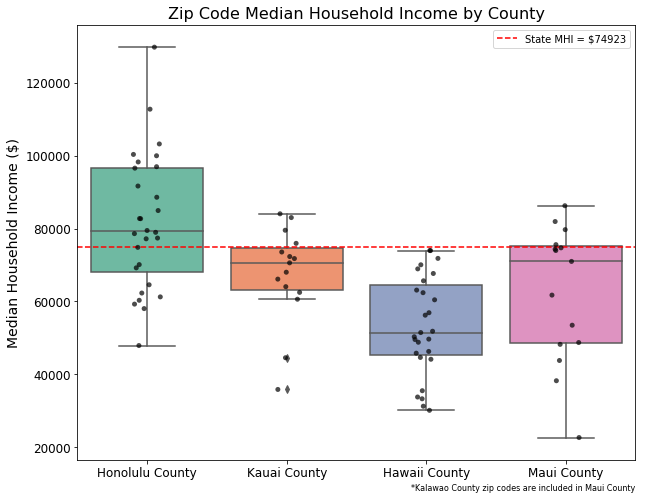

In [128]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#Setting the stage
plt.figure(figsize = (10,8))

#Boxplot print
ax = sns.boxplot(x ='County', y = 'MHI', 
                 data = df_zip, 
                 palette="Set2", 
                 saturation = 0.8)

#Adding zip code data points
#ax = sns.swarmplot(x = 'County', y = 'MHI', data = df_zip,color = "black", alpha = .7)
ax = sns.stripplot(x = 'County', y = 'MHI', 
                   data = df_zip, 
                   jitter = True, 
                   color = 'black', 
                   alpha = 0.7)

#State MHI Line
ax.axhline(df_state.loc[df_state['GeoID'] == 15, 'MHI'][0], 
           ls = '--', 
           label = 'State MHI = ${}'.format(int(df_state.loc[df_state['GeoID'] == 15, 'MHI'][0])), 
           color = 'Red')

#Figure Details
ax.legend()
ax.set_title("Zip Code Median Household Income by County",fontsize = 16)
ax.set_xlabel("*Kalawao County zip codes are included in Maui County", 
              position = (1, 0), horizontalalignment = 'right', fontsize = 8)
ax.set_ylabel("Median Household Income ($)", fontsize = 14)
ax.tick_params(labelsize = 12)
